## EDA

In [1]:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import os
os.chdir(r'C:\Users\82104\DM\project')

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode(connected = True)

import pandas_profiling as pp 
import sweetviz as sv

import warnings
warnings.filterwarnings('ignore')

In [2]:
# df_eda is data of variables by district(local) for clustering
df_eda = pd.read_csv(r'data_for_clustering.csv', encoding ='UTF8') # 최종 df table(클러스터링)
df_eda.head()

# df_eda_2 = analyze_data.to_csv('./analyze_data.csv')
## regression에 필요한 data 하나 더 불러와서, 변수와 타겟변수 간 EDA (상관관계, 박스플롯)

,DISTRICT,DRIVEN_EFF,TOTAL_LOGIS,POP2040,TOTAL_SALES,NUM_STORE,ESTATE
0,동대문구,0.027219,2400374,166805,4.447564e+12,66655,5198000
1,용산구,0.131360,2250955,112398,6.805869e+12,62840,10079000
2,구로구,0.054334,2442377,184583,2.806535e+12,69651,4109000
3,노원구,0.026526,2507172,215172,1.834499e+12,57391,3911000
4,서초구,0.159699,2165093,185381,6.456707e+12,117682,11141000


In [3]:
# data size
# df_eda has 25 observation, 8 columns by district  
df_eda.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DISTRICT     25 non-null     object 
 1   DRIVEN_EFF   25 non-null     float64
 2   TOTAL_LOGIS  25 non-null     int64  
 3   POP2040      25 non-null     int64  
 4   TOTAL_SALES  25 non-null     float64
 5   NUM_STORE    25 non-null     int64  
 6   ESTATE       25 non-null     int64  
dtypes: float64(2), int64(4), object(1)
memory usage: 1.5+ KB


In [4]:
# check missing values
# no missing values
df_eda.isnull().sum()

DISTRICT       0
DRIVEN_EFF     0
TOTAL_LOGIS    0
POP2040        0
TOTAL_SALES    0
NUM_STORE      0
ESTATE         0
dtype: int64

There is no Null values.

In [5]:
'''
There is 25 districts in seoul.

An average of 23600,000 parcels are transported to each districts
Up to 2,678,624 and at least 2,034,893 parcels would be transported.

The minimum official land price for each district is 2678624 won and the maximum is 3451000 won.

상관관계 
Estate & Num_Store - HIgh correlation
Estate & Sales-상권매출액 강한 상관관계
'''
profile = pp.ProfileReport(df_eda)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
report = sv.analyze(df_eda)

# View and Save
report.show_html()

                                             |                                             | [  0%]   00:00 ->…

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


Text(0, 0.5, 'ESTATE amount ($)')

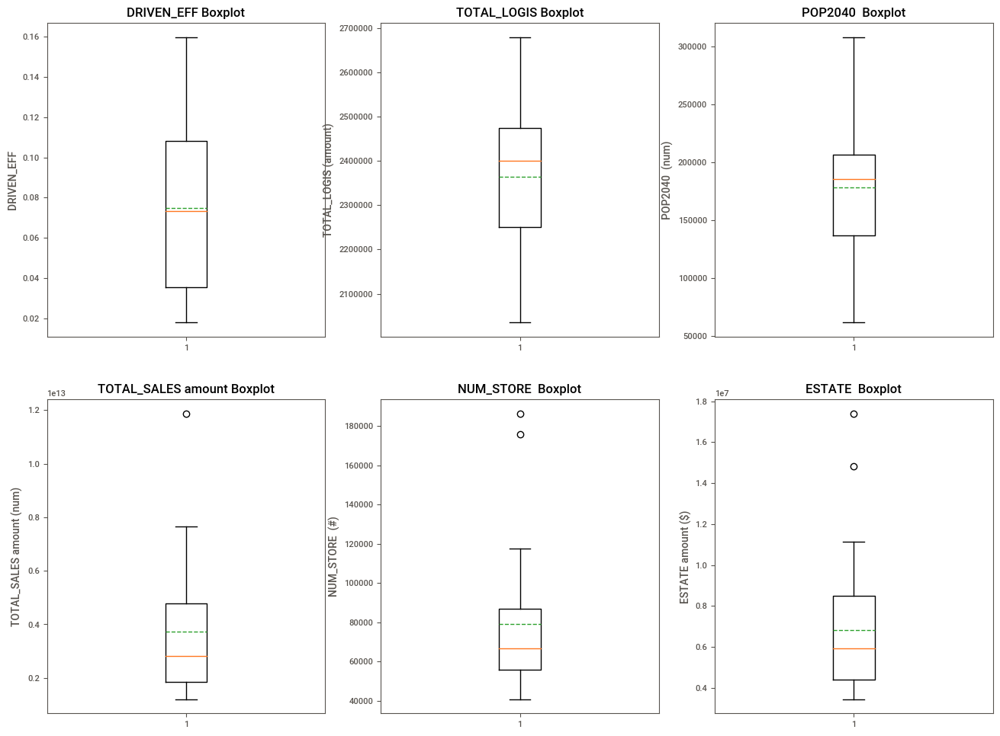

In [7]:
plt.figure(figsize=[16,12])

plt.subplot(231)
plt.boxplot(x=df_eda['DRIVEN_EFF'], showmeans = True, meanline = True)
plt.title('DRIVEN_EFF Boxplot')
plt.ylabel('DRIVEN_EFF')

plt.subplot(232)
plt.boxplot(df_eda['TOTAL_LOGIS'], showmeans = True, meanline = True)
plt.title('TOTAL_LOGIS Boxplot')
plt.ylabel('TOTAL_LOGIS (amount)')

plt.subplot(233)
plt.boxplot(df_eda['POP2040'], showmeans = True, meanline = True)
plt.title('POP2040  Boxplot')
plt.ylabel('POP2040  (num)')

plt.subplot(234)
plt.boxplot(df_eda['TOTAL_SALES'], showmeans = True, meanline = True)
plt.title('TOTAL_SALES amount Boxplot')
plt.ylabel('TOTAL_SALES amount (num)')

plt.subplot(235)
plt.boxplot(df_eda['NUM_STORE'], showmeans = True, meanline = True)
plt.title('NUM_STORE  Boxplot')
plt.ylabel('NUM_STORE  (#)')

plt.subplot(236)
plt.boxplot(df_eda['ESTATE'], showmeans = True, meanline = True)
plt.title('ESTATE  Boxplot')
plt.ylabel('ESTATE amount ($)')

According to ProfileReport, sweetviz and Box plot, we can find 5 statistic numbers.

  
<center>Five numbers(Min, Q1, Mean, Q3, Max)</center>

|Column|Min|Q1|Median|Q3|Max|
|------|------|------|------|-----|-----|
|DRIVEN_EFF|0.018|0.035|0.073|0.108|0.16|
|TOTAL_LOGIS|2035k|2251k|2400k|2474k|2679k|
|POP2040|62k|137k|185k|207k|308k|
|TOTAL_SALES|1.2T|1.9T|2.8T|4.8T|11.9T|
|NUM_STORE|41k|56k|67k|87k|186k|
|ESTATE|3.5M|4.4M|5.9M|8.5M|17.4M|

<center>k(kilo), M(million), T(trillion)</center>

## EDA by DISTRICT

Visualization with barplot and choropleth. Compare the 25 districts.

In [8]:
import plotly.express as px
import json 

In [9]:
geometry = json.load(open('LARD_ADM_SECT_SGG_11.json', encoding='utf-8'))

In [10]:
location = pd.read_excel('korea_administrative_division_latitude_longitude.xlsx')

In [11]:
location = location[location['do'] == '서울'].reset_index(drop=True)

In [12]:
location.drop(['docity', 'do'], axis=1, inplace=True)

In [13]:
location

,city,longitude,latitude
0,강남구,127.049556,37.514575
1,강동구,127.125864,37.527367
2,강북구,127.027719,37.636956
3,강서구,126.851675,37.548156
4,관악구,126.953844,37.475386
5,광진구,127.084533,37.535739
6,구로구,126.889597,37.492650
7,금천구,126.904197,37.449108
8,노원구,127.058389,37.651461
9,도봉구,127.049522,37.665833


In [14]:
df_eda = pd.merge(df_eda, location, left_on='DISTRICT', right_on='city').drop('city', axis=1)

In [15]:
df_eda.columns = df_eda.columns.str.upper()

In [16]:
df_eda

,DISTRICT,DRIVEN_EFF,TOTAL_LOGIS,POP2040,TOTAL_SALES,NUM_STORE,ESTATE,LONGITUDE,LATITUDE
0,동대문구,0.027219,2400374,166805,4.447564e+12,66655,5198000,127.042142,37.571625
1,용산구,0.131360,2250955,112398,6.805869e+12,62840,10079000,126.967522,37.536094
2,구로구,0.054334,2442377,184583,2.806535e+12,69651,4109000,126.889597,37.492650
3,노원구,0.026526,2507172,215172,1.834499e+12,57391,3911000,127.058389,37.651461
4,서초구,0.159699,2165093,185381,6.456707e+12,117682,11141000,127.034811,37.480786
5,마포구,0.142776,2067762,191766,4.087616e+12,99849,9213000,126.910531,37.560706
6,성북구,0.082233,2484878,199990,1.380648e+12,52834,4507000,127.020333,37.586383
7,강북구,0.017854,2202978,122596,1.482913e+12,48726,3705000,127.027719,37.636956
8,도봉구,0.111866,2034893,126118,1.210447e+12,40786,3451000,127.049522,37.665833
9,금천구,0.066146,2201708,111478,3.490343e+12,55524,3870000,126.904197,37.449108


### Barplot & Choropleth

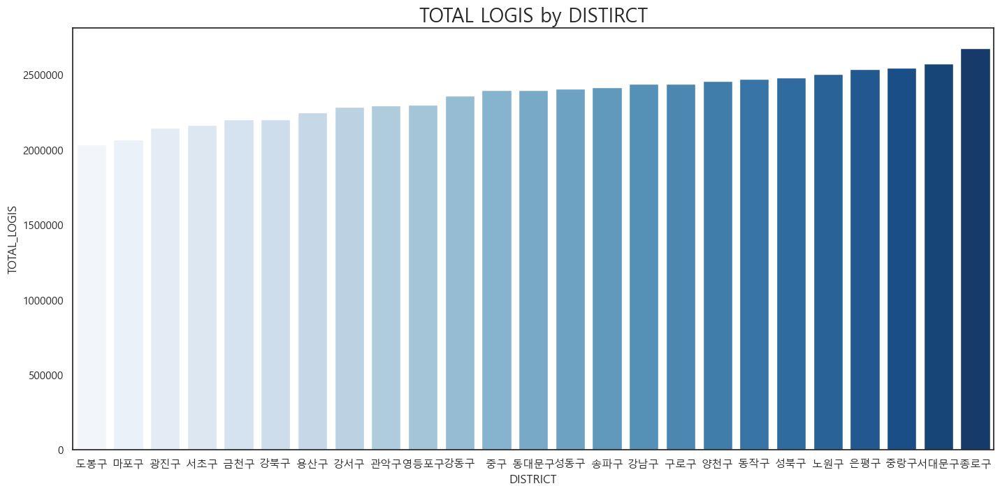

In [17]:
import seaborn as sns
sns.set(font="Malgun Gothic",
rc={"axes.unicode_minus":False, 'figure.figsize':(12,8)}, style='white')

asdf = 'DISTRICT'
plt.figure(figsize = (17,8))
sns.barplot(data = df_eda, y = 'TOTAL_LOGIS', x = asdf, color = 'coral', palette = 'Blues',
            order = df_eda.sort_values('TOTAL_LOGIS').DISTRICT).set_title('TOTAL LOGIS by DISTIRCT', size = 20)
plt.show()

In [18]:
# Choropleth
fig = px.choropleth(df_eda, geojson=geometry, locations='DISTRICT', color='TOTAL_LOGIS',
                                color_continuous_scale='Blues',
                                featureidkey='properties.SGG_NM')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text='Total Logistics In Seoul', title_font_size=20)

There are a lot of logistics in Jongno-Gu, but Dobong-Gu does not.

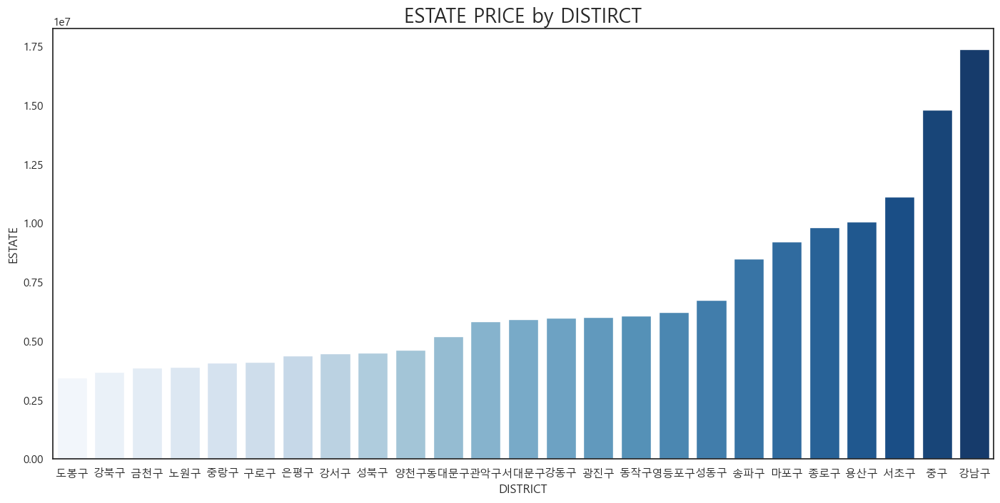

In [19]:
a = 'DISTRICT'
b = 'ESTATE'
plt.figure(figsize = (17,8))
sns.barplot(data = df_eda, y = b, x = a, palette = 'Blues', order = df_eda.sort_values('ESTATE').DISTRICT).set_title('ESTATE PRICE by DISTIRCT', 
                                                                                   size = 20)
plt.show()

In [20]:
# Choropleth
fig = px.choropleth(df_eda, geojson=geometry, locations='DISTRICT', color='ESTATE',
                                color_continuous_scale='Blues',
                                featureidkey='properties.SGG_NM')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text='ESTATE PRICE In Seoul', title_font_size=20)

ESTATE PRICE is especially high in Gangnam-Gu, and Dobong-Gu is lowest. and there is little difference of estate price among district where is lower estate price(Dobong-Gu ~ Guro-Gu).

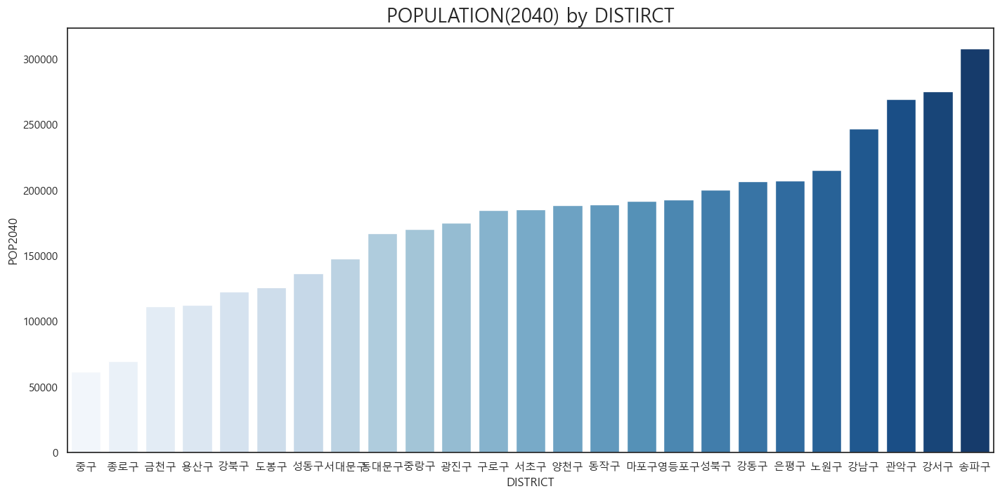

In [21]:
plt.figure(figsize = (17,8))
sns.barplot(data = df_eda, y = 'POP2040', x = a, palette = 'Blues', order = df_eda.sort_values('POP2040').DISTRICT).set_title('POPULATION(2040) by DISTIRCT', 
                                                                                   size = 20)
plt.show()

In [22]:
# Choropleth
fig = px.choropleth(df_eda, geojson=geometry, locations='DISTRICT', color='POP2040',
                                color_continuous_scale='Blues',
                                featureidkey='properties.SGG_NM')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text='POPULATION(2040) In Seoul', title_font_size=20)

People live in Songpa-gu the most. and Jung-Gu & Jongno-Gu are lower population.

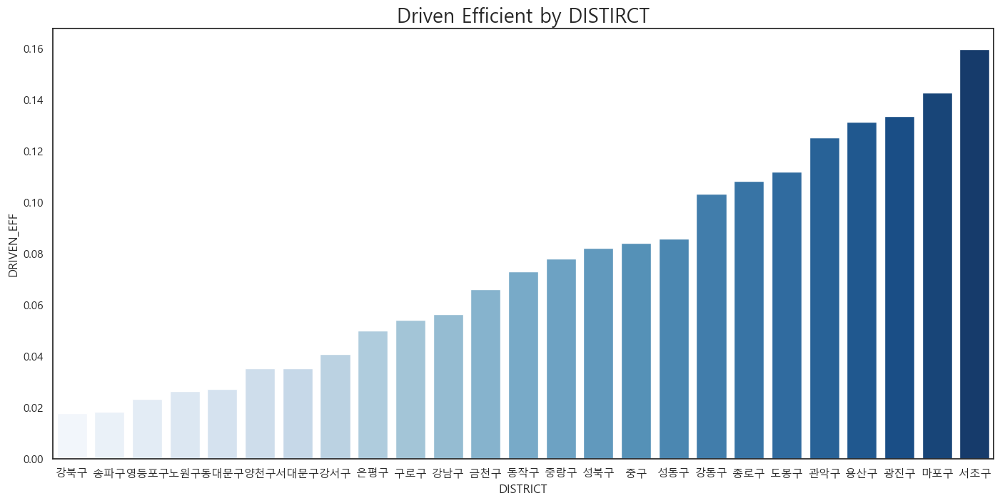

In [23]:
plt.figure(figsize = (17,8))
sns.barplot(data = df_eda, y = 'DRIVEN_EFF', x = a, palette = 'Blues', order = df_eda.sort_values('DRIVEN_EFF').DISTRICT).set_title('Driven Efficient by DISTIRCT', 
                                                                                   size = 20)
plt.show()

In [24]:
# Choropleth
fig = px.choropleth(df_eda, geojson=geometry, locations='DISTRICT', color='DRIVEN_EFF',
                                color_continuous_scale='Blues',
                                featureidkey='properties.SGG_NM')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text='Driven Efficient In Seoul', title_font_size=20)

Driven Efficient is lowest in Gangbuk-Gu and Songpa-Gu, and highest in Seocho-Gu.

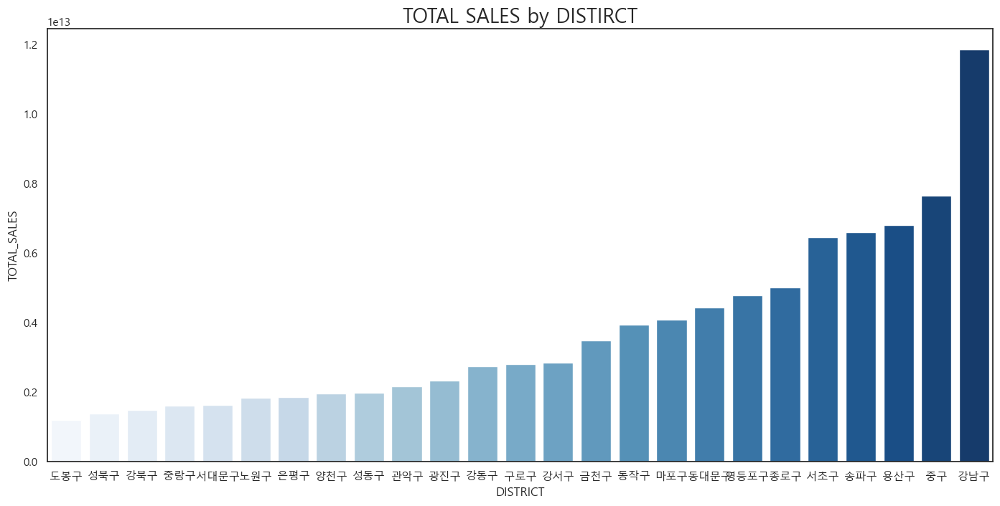

In [25]:
plt.figure(figsize = (17,8))
sns.barplot(data = df_eda, y = 'TOTAL_SALES', x = a, palette = 'Blues', order = df_eda.sort_values('TOTAL_SALES').DISTRICT).set_title('TOTAL SALES by DISTIRCT', 
                                                                                   size = 20)
plt.show()

In [26]:
# Choropleth
fig = px.choropleth(df_eda, geojson=geometry, locations='DISTRICT', color='TOTAL_SALES',
                                color_continuous_scale='Blues',
                                featureidkey='properties.SGG_NM')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text='TOTAL_SALES In Seoul', title_font_size=20)

Total sales is especially high in Gangnam-Gu, and Dobong-Gu is lowest.

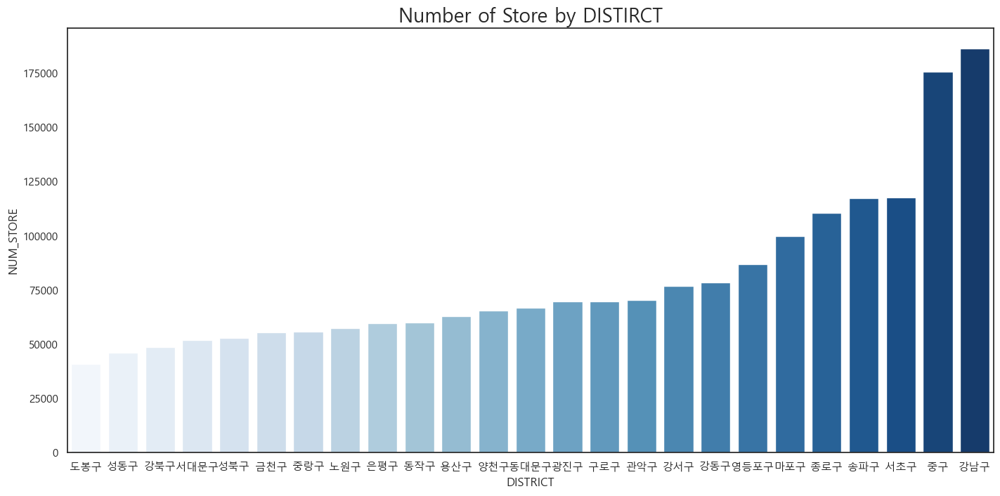

In [27]:
plt.figure(figsize = (17,8))
sns.barplot(data = df_eda, y = 'NUM_STORE', x = a, palette = 'Blues', order = df_eda.sort_values('NUM_STORE').DISTRICT).set_title('Number of Store by DISTIRCT', 
                                                                                   size = 20)
plt.show()

In [28]:
# Choropleth
fig = px.choropleth(df_eda, geojson=geometry, locations='DISTRICT', color='NUM_STORE',
                                color_continuous_scale='Blues',
                                featureidkey='properties.SGG_NM')
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text='Number of Store In Seoul', title_font_size=20)

The number of store is especially high in Gangnam-Gu, and Dobong-Gu is lowest.

We find fact that the results of Total sales, Number of store, Estate price is similarity.  
So, we will visualize correlation among them.

### Heatmap among variables

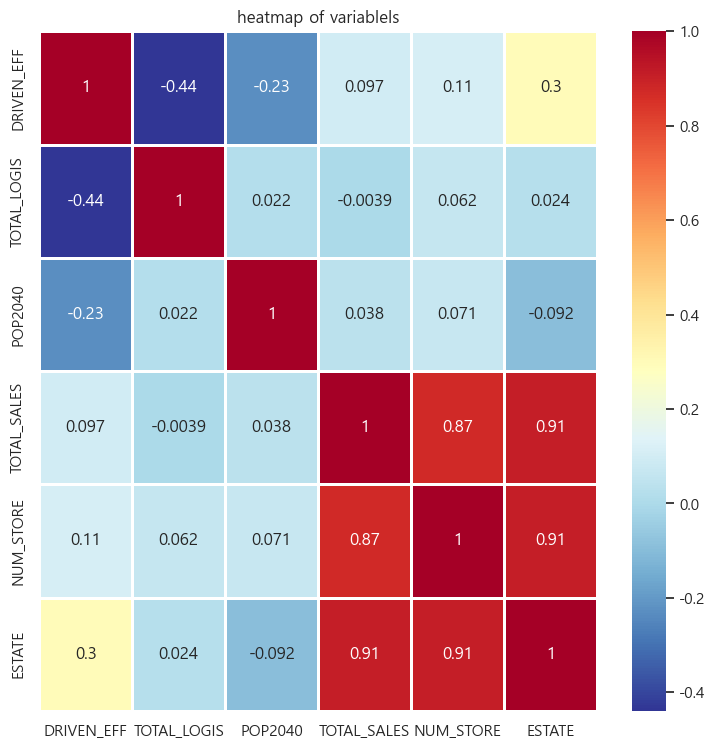

In [29]:
# corr 높게 나오는 거 아래에서 구체적으로 EDA (통계량 추출, 시각화)

plt.figure(figsize= (9, 9))
sns.heatmap(data = df_eda.iloc[:,:-2].corr(),
           annot = True,
           linewidths = 1,
           cmap = 'RdYlBu_r').set_title('heatmap of variablels')
plt.show()

There is high positive correlation between estate & total sales.  
also, estate & num store is high positive correlation.
total_sales and num_store is also high positive correlation.

We had already thought that the total_sales & num_store were positively correlated.  
But we didn't know there was a correlation between estate & num_store and estate & total_sales.  
This is surprise result.